<a href="https://colab.research.google.com/github/kennethugo/field_and_road_classifier/blob/main/field_road_classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# A two class classifier : Field & Road

# New Section

In this exercise, the main task is to create a two class classifier that classifies field and road images. This task is one part of the Trimble / Bilberry AI Engineer technical exercise for the AI Engineer position. To solve this problem, I will be using the transfer learning and fine tuning technique, where the weights of a pre-trained model that was pre-trained on ImageNets dataset will be used to customize and train the field and road classifier model. In this case we will be using that of MobilenetV2, this is because MobileNetV2, has been designed to provide fast and computationally efficient performance. I have decided to use tranfer learning and finetuning because of the small number of the dataset.

The dataset that has been made available for this computer vision task has two classes namely field abd road. Originally, there are 45 image files in the field image folder and 108 image files in the road folders, also a test folder with 10 images of both fields and roads have been provided. There is a significant level of data imblance in the original dataset, which will make the sucess of the exercise dependant on the preprocessing of this dataset that is not just small  but also highly imbalance. I will explore techniques like data augumentation, oversampling and class weighting to try to reduce the effect of the data imbalance on the training dataset and results. Transfer learning and finetuning technique will implemented to creating this binary classifier since the provided dataset. During finetunning i will use apply other regularization techniques like dropout to check this overfitting of the model. At the end, metrics like accuracy, precision and recall will be used to evaluate the performance of the model.

<div style="margin-bottom: 20px;">
    <p>These are two examples from the field and road class displayed side by side with their titles:</p>
</div>

<div style="display: flex; justify-content: space-between; align-items: center;">
    <div>
        <img src="/content/extracted_data/dataset/fields_and_road/fields/4.jpg" alt="Field" style="width:300px;height:220px;">
        <p style="text-align: center;">Field</p>
    </div>
    <div>
        <img src="/content/extracted_data/dataset/fields_and_road/roads/4.jpg" alt="Road" style="width:300px;height:220px;">
        <p style="text-align: center;">Road</p>
    </div>
</div>




# Import tensorflow and other packages


In [1]:
import tensorflow as tf
print("tensorflow version: ",tf.__version__)

tensorflow version:  2.12.0


In [2]:
try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [3]:
# import needed libraries
import os
import datetime
import cv2
import numpy as np
import shutil
import matplotlib.pyplot as plt
import tensorflow.keras.layers as tfl
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.layers.experimental.preprocessing import RandomFlip, RandomRotation
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard
from tensorflow.keras.metrics import Precision, Recall
import time
import requests
import gdown
import zipfile





# Load the TensorBoard notebook extension
%load_ext tensorboard

In [4]:

# Clear any logs from previous runs
log_dir = "/content/logs"
shutil.rmtree(log_dir, ignore_errors=True)

# Download and Dsiplay filed and road dataset


In [6]:
# Dowload tdata as zip, extract and navigate to the current directory
file_id = "1pOKhKzIs6-oXv3SlKrzs0ItHI34adJsT"
download_url = f"https://drive.google.com/uc?id={file_id}"

# Download the file
response = requests.get(download_url)
with open("data.zip", "wb") as f:
    f.write(response.content)

# Extract the contents of the ZIP archive
extracted_dir = "extracted_data"
os.makedirs(extracted_dir, exist_ok=True)
with zipfile.ZipFile("data.zip", "r") as zip_ref:
    zip_ref.extractall(extracted_dir)


In [7]:
# List files in the current working directory
files_in_directory = os.listdir()
# Print the list of files
print(files_in_directory)

['.config', 'data.zip', '.ipynb_checkpoints', 'extracted_data', 'drive', 'sample_data']


In [13]:
%cd extracted_data/

/content/extracted_data


In [6]:
%ls


data.zip  drive/  extracted_data/  sample_data/


In [47]:
current_directory = os.getcwd()
print("Current working directory:", current_directory)

Current working directory: /content


Seperate the test_images folder outside the dataset directory from the fields and roads

*   The dataset folder wil have subdirectories of the field and roads directories.
*   The test_image folder will be in directly under the parent directory the extrated data



In [8]:
# Creat a new directory that has as sub-directories fields and road directories
try:
  # Create a new folder named 'fields_and_road'
  fields_and_road = '/content/extracted_data/dataset/fields_and_road'
  os.mkdir(fields_and_road)

  # Move the 'fields' and 'roads' folders into the new folder
  shutil.move('/content/extracted_data/dataset/fields', fields_and_road)
  shutil.move('/content/extracted_data/dataset/roads', fields_and_road)

except OSError:
    pass
print("Total number of directories:",len(os.listdir(fields_and_road)))

Total number of directories: 2


In [9]:
# Check number of examples in the dataset
fields_dir = '/content/extracted_data/dataset/fields_and_road/fields'
roads_dir = '/content/extracted_data/dataset/fields_and_road/roads'
test_dir = '/content/extracted_data/dataset/test_images'

num_fields = len(os.listdir(fields_dir))
num_roads = len(os.listdir(roads_dir))
num_test_images = len(os.listdir(test_dir))

print("Number of cat fields:", num_fields)
print("Number of roads:", num_roads)
print("Number of test:", num_test_images)

Number of cat fields: 43
Number of roads: 108
Number of test: 10


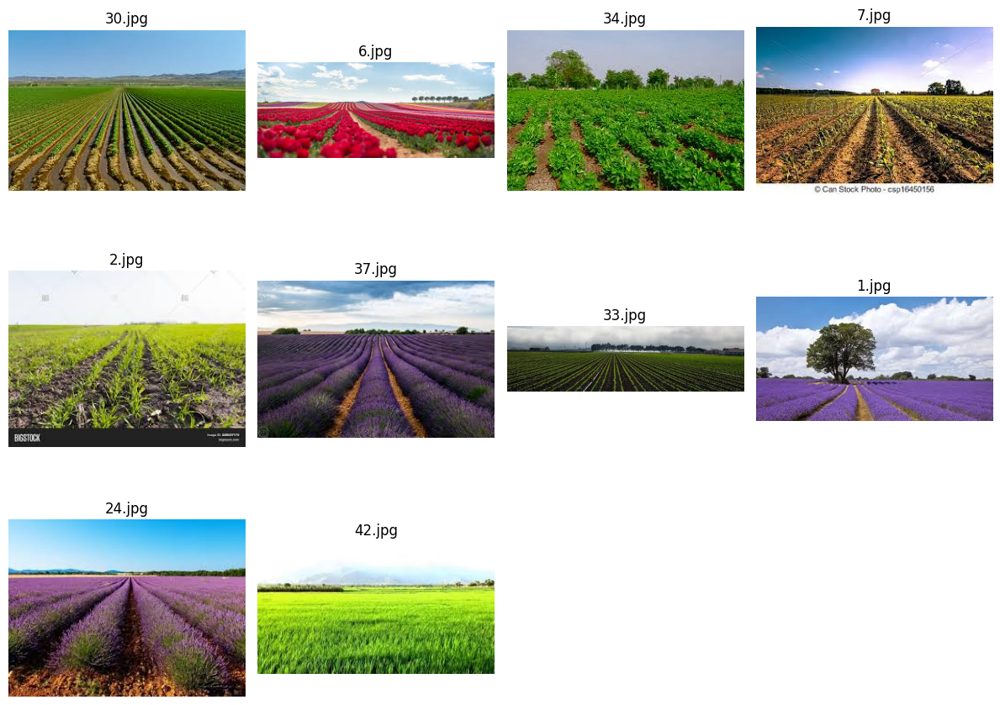

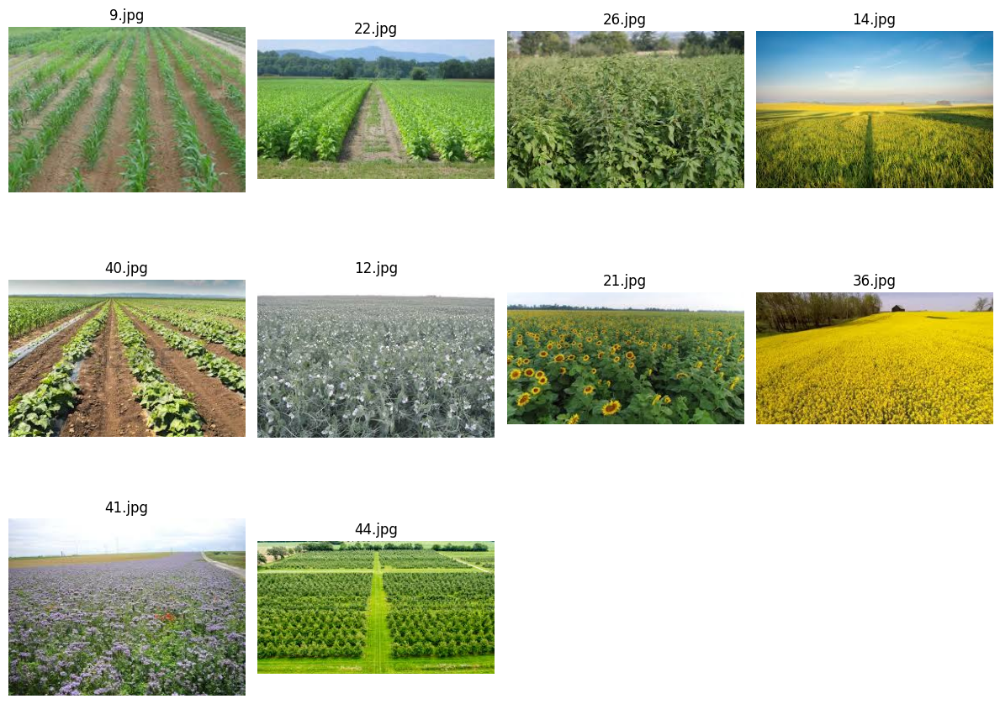

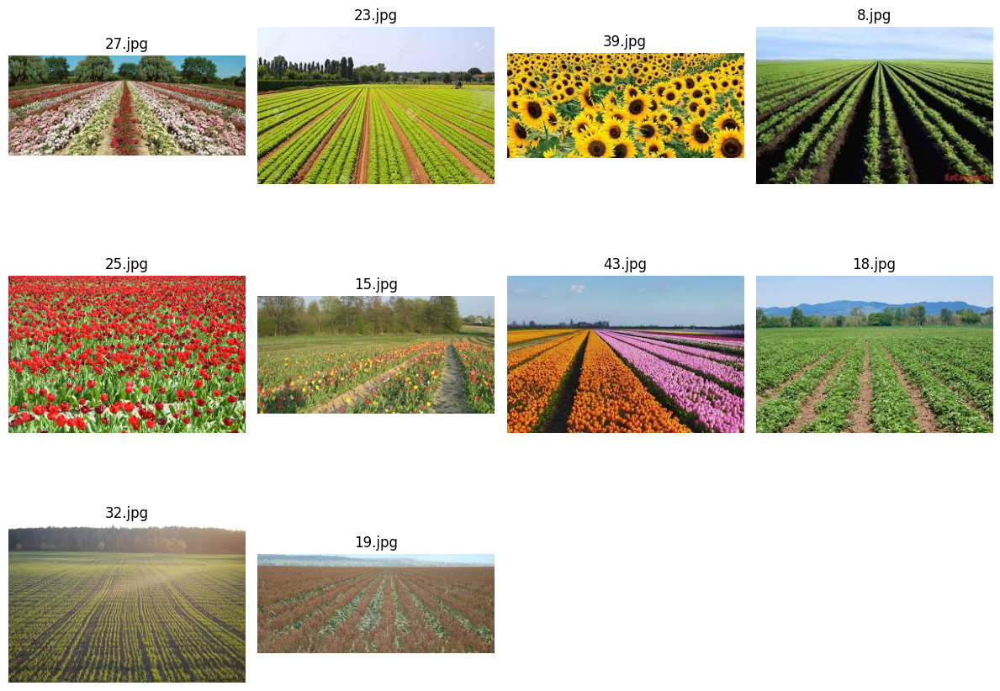

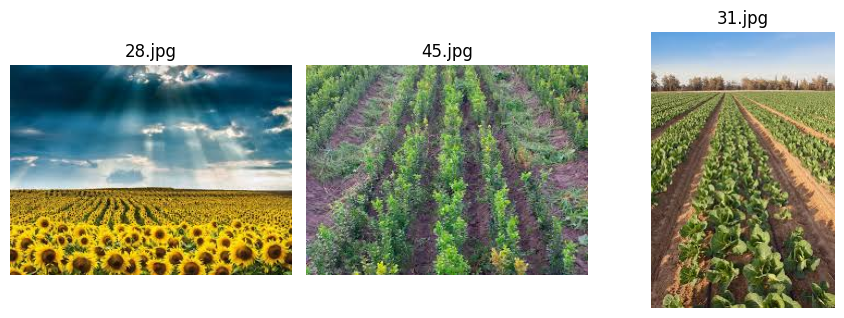

In [10]:
# Display the images

# Specify the path to the image folder
image_folder = '/content/extracted_data/dataset/fields_and_road/fields/'

# Get a list of all image files in the folder
image_files = [file for file in os.listdir(image_folder) if file.endswith('.jpg')]

# Define the ranges for each batch of images
ranges = [(0, 10), (10, 20), (20, 30), (40, len(image_files))]

# Loop through each range of images and display them in subplots
for start, end in ranges:
    batch_files = image_files[start:end]

    plt.figure(figsize=(12, 12))
    for i, image_file in enumerate(batch_files):
        image_path = os.path.join(image_folder, image_file)
        image = cv2.imread(image_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plt.subplot(4, 4, i + 1)
        plt.imshow(image_rgb)
        plt.title(image_file)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


In [11]:
# Delete wrongly labeled data
files_to_delete = ['/content/extracted_data/dataset/fields_and_road/fields/5.jpg',
                   '/content/extracted_data/dataset/fields_and_road/fields/3.jpg']

for file_to_delete in files_to_delete:
    try:
        os.remove(file_to_delete)
        print(f"{file_to_delete} has been deleted.")
    except FileNotFoundError:
        print(f"{file_to_delete} not found.")

/content/extracted_data/dataset/fields_and_road/fields/5.jpg not found.
/content/extracted_data/dataset/fields_and_road/fields/3.jpg not found.


# 1.1 Create and split the Dataset into Training and Validation Sets

In [14]:
# Define class names, directories
# specify the train/val subsets and match the seeds to prevent overlap

BATCH_SIZE = 16  # batch size
IMG_SIZE = (224, 224)  #Image size
class_names = ['fields', 'roads']
directory = fields_and_road # directory with the two subdirectories
test_directory = "dataset/test" # test directory

In [15]:
train_dataset = image_dataset_from_directory(directory,
                                             shuffle=True,
                                             batch_size=BATCH_SIZE, # use specified batch size
                                             image_size=IMG_SIZE, # use specified image size
                                             validation_split=0.2, # split size 80% train /20% validation
                                             subset='training', # specify the train subsets
                                             seed=42) # prevent overlapping by matching seeds

validation_dataset = image_dataset_from_directory(directory,
                                             shuffle=True,
                                             batch_size=BATCH_SIZE, # use specified batch size
                                             image_size=IMG_SIZE, # use specified image size
                                             validation_split=0.2,  # split size 80% train /20% validation
                                             subset='validation', # specify the val subsets
                                             seed=42) # prevent overlapping by matching seeds

Found 151 files belonging to 2 classes.
Using 121 files for training.
Found 151 files belonging to 2 classes.
Using 30 files for validation.


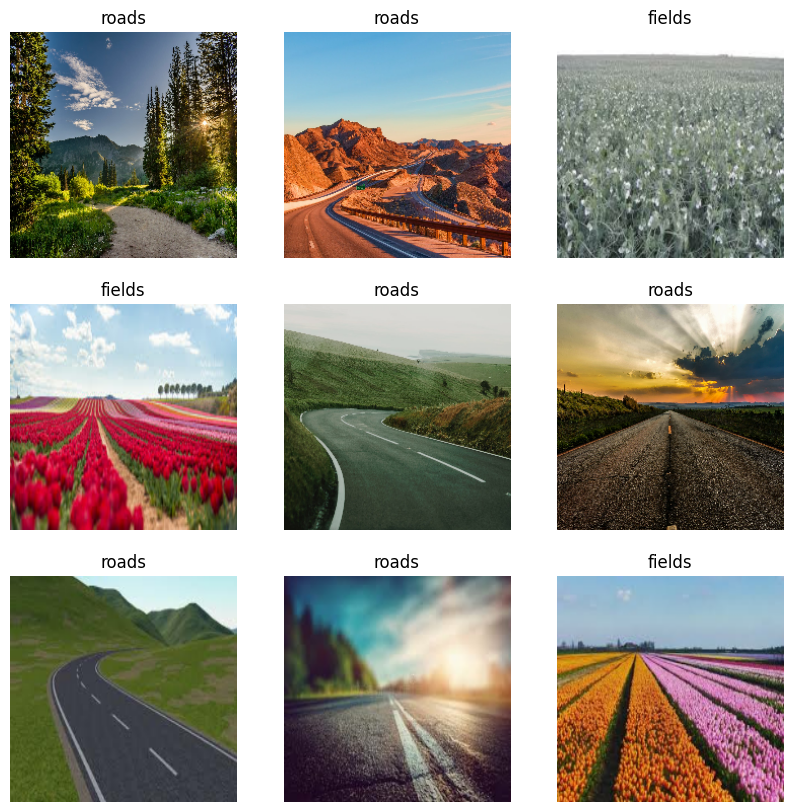

In [16]:
# Display some images in the just splitted training set
class_names = train_dataset.class_names

plt.figure(figsize=(10, 10))
for images, labels in train_dataset.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

In [17]:
# Verify class names and indices
class_names = train_dataset.class_names
class_names = os.listdir(fields_and_road)
class_indices = {class_name: index for index, class_name in enumerate(class_names)}
print(f'class_indices = {class_indices}, class_name ={class_names} ')


class_indices = {'roads': 0, 'fields': 1}, class_name =['roads', 'fields'] 


# 1.2 Calculate class weights

In [18]:
# Calculate class weights
all_train_labels = []

# Iterate through the dataset to extract labels from all batches
for images, labels in train_dataset:
    all_train_labels.extend(labels.numpy())

# Convert the list of labels to a NumPy array
train_labels = np.array(all_train_labels)

class_counts = [np.sum(train_labels == class_indices[class_name]) for class_name in class_names]
total_samples = np.sum(class_counts)
class_weights = {class_indices[class_name]: total_samples / (len(class_names) * count) for class_name, count in zip(class_names, class_counts)}

print(f"class weight= {class_weights}")
count_of_ones = 0
count_of_zeros = 0
for i in all_train_labels:
    if i == 1:
        count_of_ones += 1
    elif i == 0:
        count_of_zeros += 1

print(f'number of roads = {count_of_ones}')
print(f'number of fields = {count_of_zeros}')
print(f"total ={count_of_ones + count_of_zeros}")

class weight= {0: 1.635135135135135, 1: 0.7202380952380952}
number of roads = 84
number of fields = 37
total =121


# 2. Preprocess and Augment training Data

In [19]:
# Use prefetch to avoid memmory bottleneck while reading data from disk
AUTOTUNE = tf.data.experimental.AUTOTUNE # automatically choose number of element to prefetch
train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE) #using prefectch to prevent memory bottleneck, since its reading from disk

# 2.1 Data augmentation

In [20]:
def augmenter_de_data():
    '''
    Create a Sequential model composed of 4 layers
    for data augumentation using
    RandomFlip('horizontal')
    RandomRotation(0.2)
    RandomZoom(0.2)

    Returns:
        tf.keras.Sequential
    '''
    augmented_data = tf.keras.Sequential()
    augmented_data.add(RandomFlip('horizontal'))
    augmented_data.add(RandomRotation(0.1))
    augmented_data.add(tf.keras.layers.RandomZoom(0.3))


    return augmented_data

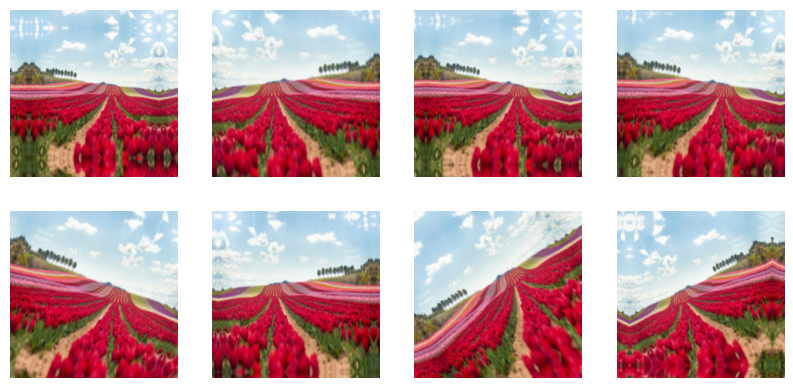

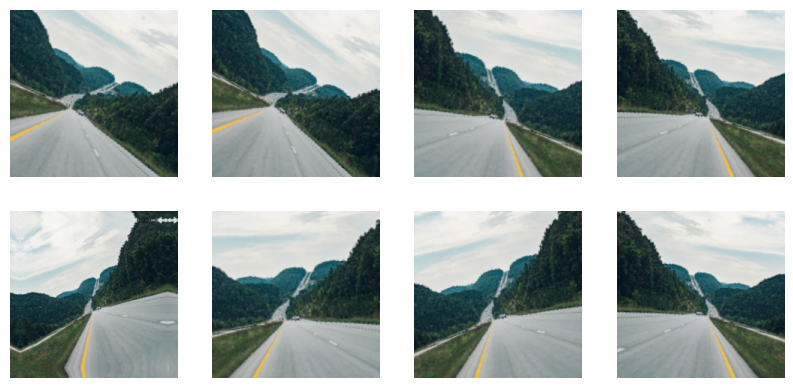

In [21]:
# Display two different augmented images from the training set
augmented_data = augmenter_de_data()

for img, _ in train_dataset.take(2):
    plt.figure(figsize=(10, 10))
    img_1 = img[0]
    for i in range(8):
        ax = plt.subplot(4, 4, i + 1)
        augmented_img = augmented_data(tf.expand_dims(img_1, 0))
        plt.imshow(augmented_img[0] / 255)
        plt.axis('off')

# 2.2 Preprocess inputs

In [22]:
# Preproces inputs using the same preprocessing that was used during traning of mobilenetV2
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

# 2.3 Early stopping

In [23]:
# specify EarlyStopping callback
early_stopping = EarlyStopping(
    monitor='val_loss',  # Monitor validation loss for early stopping
    patience=5,           # Number of epochs with no improvement before stopping
    restore_best_weights=True  # Restore model weights from the epoch with the best value of monitored quantity
)

# 2.4 Metrics

In [24]:
def f1_score(y_true, y_pred):
    precision = Precision()(y_true, y_pred)
    recall = Recall()(y_true, y_pred)
    return 2 * (precision * recall) / (precision + recall + tf.keras.backend.epsilon())

In [25]:
# Define other metrics for evaluation
metrics = [
    'accuracy',
    Precision(name='precision'),
    Recall(name='recall'),

]


# Build the model

In [26]:
# Using a pretrained model and modifying the original classifier layer to achive a binary classifier.

def field_road_model(image_shape=IMG_SIZE, dropout_rate = 0.2, augmented_data=augmenter_de_data()):
    ''' Build binary classification model out of the MobileNetV2 model using tf.keras
    Arguments:
        image_shape -- height and width of
        augmented_data -- function that performs data augmentation

    Returns:
        tf.keras.model
    '''
    input_shape = image_shape + (3,)

    # loads the pre-trained  weights
    base_model = tf.keras.applications.MobileNetV2(input_shape=input_shape,
                                                   include_top=False, # <== Important!!!!
                                                   weights='imagenet') # From imageNet


    # make base model untrainable by freezing it
    base_model.trainable = False

    # input layer as the Same as the imageNetv2 input size
    inputs = tf.keras.Input(shape=input_shape)

    # augment the inputs data
    x = augmented_data(inputs)


    # preprocessing data with the same weights the model was trained on
    x = preprocess_input(x)


    # avoid keeping track of statistics in the batch norm layer by setting training to false
    x = base_model(x, training=False)

    # add the new Binary classification layers and global average pooling t
    x = tf.keras.layers.GlobalAveragePooling2D()(x)

    # to avoid overfitting, apply dropout probability of 0.2
    x = tf.keras.layers.Dropout(dropout_rate)(x)

    # apply a prediction layer with one neuron for binary classification
    outputs = tf.keras.layers.Dense(1)(x)


    model = tf.keras.Model(inputs, outputs)

    return model

In [33]:
dropout_rate = 0.4
fields_and_road_model = field_road_model(IMG_SIZE, dropout_rate, augmented_data)
fields_and_road_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 tf.math.truediv_1 (TFOpLamb  (None, 224, 224, 3)      0         
 da)                                                             
                                                                 
 tf.math.subtract_1 (TFOpLam  (None, 224, 224, 3)      0         
 bda)                                                            
                                                                 
 mobilenetv2_1.00_224 (Funct  (None, 7, 7, 1280)       2257984   
 ional)                                                          
                                                           

In [34]:
# set learning rate
base_learning_rate = 0.001

fields_and_road_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics = metrics)

In [35]:
#path for saving logs
path = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

tensorboard_callback = TensorBoard(
    log_dir=path,
    histogram_freq=1,
    write_graph=True,  # Include model graph
    update_freq='epoch',  # Log at the end of each epoch
    profile_batch=0,  # Log profile info for the first batch
    embeddings_freq=0,  # Log embedding data
    embeddings_metadata=None  # Optional metadata for embeddings
)

In [36]:
initial_epochs = 5

Model_history = fields_and_road_model.fit(train_dataset,
                     validation_data=validation_dataset,
                     epochs=initial_epochs,
                     class_weight=class_weights,
                     callbacks=[early_stopping, tensorboard_callback])

Epoch 1/5
8/8 [==============================] - 11s 584ms/step - loss: 0.7158 - accuracy: 0.4876 - precision: 0.8689 - recall: 0.4907 - val_loss: 0.4653 - val_accuracy: 0.6667 - val_precision: 0.9375 - val_recall: 0.6250
Epoch 2/5
8/8 [==============================] - 4s 360ms/step - loss: 0.5256 - accuracy: 0.7355 - precision: 0.9062 - recall: 0.6905 - val_loss: 0.3719 - val_accuracy: 0.7000 - val_precision: 1.0000 - val_recall: 0.6250
Epoch 3/5
8/8 [==============================] - 4s 370ms/step - loss: 0.4156 - accuracy: 0.7438 - precision: 0.9492 - recall: 0.6667 - val_loss: 0.3033 - val_accuracy: 0.8000 - val_precision: 1.0000 - val_recall: 0.7500
Epoch 4/5
8/8 [==============================] - 4s 371ms/step - loss: 0.3187 - accuracy: 0.8430 - precision: 0.9851 - recall: 0.7857 - val_loss: 0.2097 - val_accuracy: 0.9333 - val_precision: 1.0000 - val_recall: 0.9167
Epoch 5/5
8/8 [==============================] - 4s 368ms/step - loss: 0.2979 - accuracy: 0.8595 - precision: 0.971

In [37]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

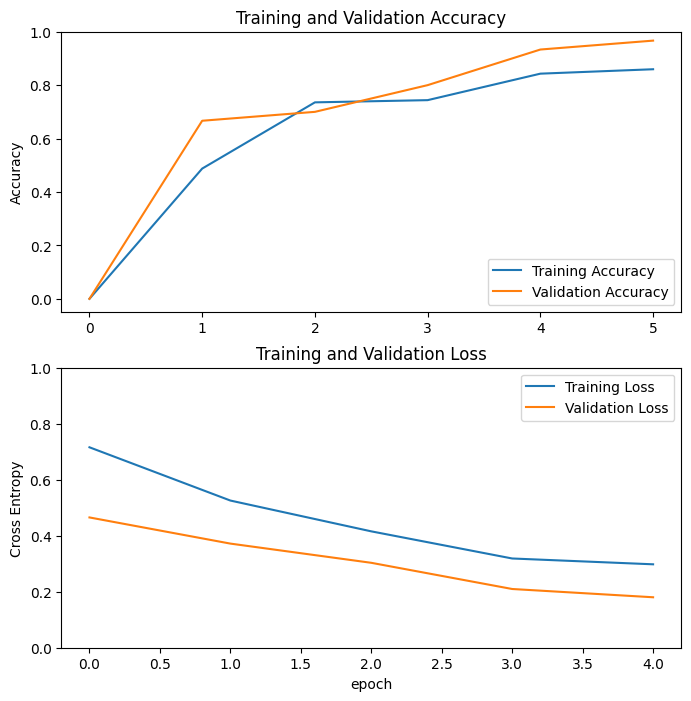

In [38]:
acc = [0.] + Model_history.history['accuracy']
val_acc = [0.] + Model_history.history['val_accuracy']

loss = Model_history.history['loss']
val_loss = Model_history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [218]:
# Evaluate the model on the test set using AUC-ROC and AUC-PR
test_dataset = validation_dataset
test_metrics = fields_and_road_model.evaluate(test_dataset)
print("Test Loss:", test_metrics[0])
print("Test Accuracy:", test_metrics[1])
print("Test Precision:", test_metrics[2])
print("Test Recall:", test_metrics[3])

# Calculate predictions for AUC-ROC and AUC-PR
test_predictions = fields_and_road_model.predict(test_dataset)
test_labels = np.concatenate([y for x, y in test_dataset], axis=0)

# Calculate AUC-ROC and AUC-PR
auc_roc = tf.keras.metrics.AUC(curve='ROC')
auc_pr = tf.keras.metrics.AUC(curve='PR')
auc_roc.update_state(test_labels, test_predictions)
auc_pr.update_state(test_labels, test_predictions)
print("Test AUC-ROC:", auc_roc.result().numpy())
print("Test AUC-PR:", auc_pr.result().numpy())

2/2 [==============================] - 0s 39ms/step - loss: 0.2188 - accuracy: 0.8667 - precision: 1.0000 - recall: 0.8333
Test Loss: 0.2187863290309906
Test Accuracy: 0.8666666746139526
Test Precision: 1.0
Test Recall: 0.8333333134651184
2/2 [==============================] - 1s 23ms/step
Test AUC-ROC: 0.6041666
Test AUC-PR: 0.87673837


# Fine-tuning the Model

In [39]:
base_model = fields_and_road_model.layers[4]
base_model.trainable = True
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 120

### START CODE HERE

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

# Define a BinaryCrossentropy loss function. Use from_logits=True
loss_function = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Define an Adam optimizer with a learning rate of 0.1 * base_learning_rate
optimizer = optimizer=tf.keras.optimizers.Adam(learning_rate=0.1*base_learning_rate)


# Define metrics for evaluation
metrics = [
    'accuracy',
    Precision(name='precision'),
    Recall(name='recall'),

]

"""
# Add dropout and L2 regularization
x = base_model.layers[-1].output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(0.5)(x)  # Add dropout layer with a dropout rate of 0.5
x = tf.keras.layers.Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)  # Use tf.keras.regularizers.l2
x = tf.keras.layers.Dropout(0.3)(x)  # Add another dropout layer
outputs = tf.keras.layers.Dense(1, activation='sigmoid')(x)
"""


#Compile the model
fields_and_road_model.compile(loss=loss_function,
              optimizer = optimizer,
              metrics=metrics)

Number of layers in the base model:  154


In [40]:
# Define additional number of epochs for fine-tuning
fine_tune_epochs = 5
total_epochs =  initial_epochs + fine_tune_epochs

# train
history_fine = fields_and_road_model.fit(train_dataset,
                         epochs=total_epochs,
                         initial_epoch=Model_history.epoch[-1],
                         validation_data=validation_dataset,
                                         class_weight=class_weights,
                                         callbacks=[early_stopping, tensorboard_callback])


Epoch 5/10
8/8 [==============================] - 19s 700ms/step - loss: 0.3136 - accuracy: 0.8430 - precision: 0.9452 - recall: 0.8214 - val_loss: 0.0899 - val_accuracy: 0.9667 - val_precision: 1.0000 - val_recall: 0.9583
Epoch 6/10
8/8 [==============================] - 4s 460ms/step - loss: 0.1018 - accuracy: 0.9587 - precision: 0.9877 - recall: 0.9524 - val_loss: 0.0669 - val_accuracy: 0.9333 - val_precision: 1.0000 - val_recall: 0.9167
Epoch 7/10
8/8 [==============================] - 5s 403ms/step - loss: 0.0661 - accuracy: 0.9669 - precision: 0.9762 - recall: 0.9762 - val_loss: 0.0190 - val_accuracy: 1.0000 - val_precision: 1.0000 - val_recall: 1.0000
Epoch 8/10
8/8 [==============================] - 4s 372ms/step - loss: 0.1785 - accuracy: 0.9174 - precision: 0.9744 - recall: 0.9048 - val_loss: 0.0125 - val_accuracy: 1.0000 - val_precision: 1.0000 - val_recall: 1.0000
Epoch 9/10
8/8 [==============================] - 4s 428ms/step - loss: 0.0563 - accuracy: 0.9339 - precision: 

In [41]:
%tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 53667), started 0:05:36 ago. (Use '!kill 53667' to kill it.)

<IPython.core.display.Javascript object>

In [42]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

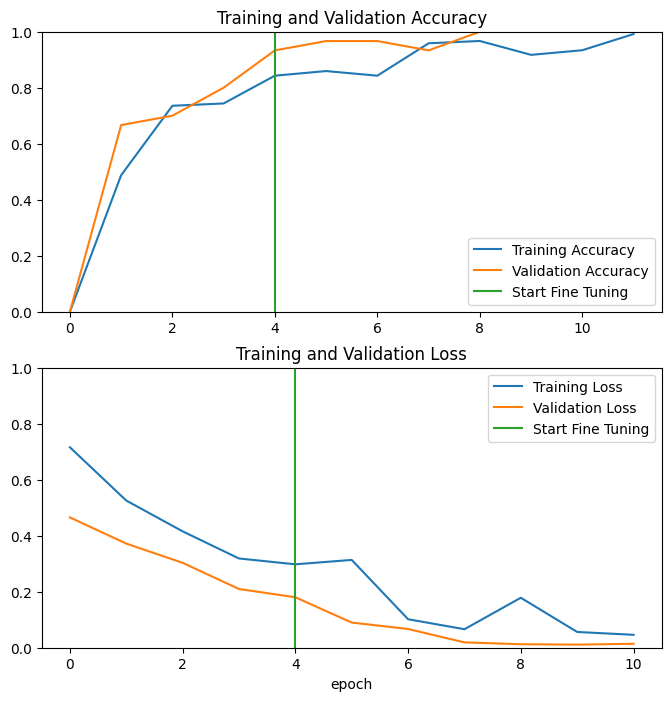

In [44]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [224]:
# Evaluate the model on the test set using AUC-ROC and AUC-PR
test_dataset = validation_dataset
test_metrics = fields_and_road_model.evaluate(test_dataset)
print("Test Loss:", test_metrics[0])
print("Test Accuracy:", test_metrics[1])
print("Test Precision:", test_metrics[2])
print("Test Recall:", test_metrics[3])

# Calculate predictions for AUC-ROC and AUC-PR
test_predictions = fields_and_road_model.predict(test_dataset)
test_labels = np.concatenate([y for x, y in test_dataset], axis=0)

# Calculate AUC-ROC and AUC-PR
auc_roc = tf.keras.metrics.AUC(curve='ROC')
auc_pr = tf.keras.metrics.AUC(curve='PR')
auc_roc.update_state(test_labels, test_predictions)
auc_pr.update_state(test_labels, test_predictions)
print("Test AUC-ROC:", auc_roc.result().numpy())
print("Test AUC-PR:", auc_pr.result().numpy())

2/2 [==============================] - 0s 37ms/step - loss: 0.0289 - accuracy: 0.9667 - precision: 1.0000 - recall: 0.9583
Test Loss: 0.028944088146090508
Test Accuracy: 0.9666666388511658
Test Precision: 1.0
Test Recall: 0.9583333134651184


2/2 [==============================] - 2s 27ms/step
Test AUC-ROC: 0.5625
Test AUC-PR: 0.8231295


In [47]:
# Save the Model:
fields_and_road_model.save('field_road_model.h5')

# Inference

In [58]:
# Predict on test images
import numpy as np
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array

from google.colab import files
# from keras.preprocessing import image
import keras.utils as image


# Define image size
IMG_SIZE = (224, 224)

# Load the model
loaded_model = tf.keras.models.load_model('field_road_model.h5')


uploaded = files.upload()

for fn in uploaded.keys():

  # predicting images
  path = '/content/' + fn

  # Load a test image
  test_image = image.load_img(path, target_size=IMG_SIZE)
  test_image_array = img_to_array(test_image)
  test_image_array = np.expand_dims(test_image_array, axis=0)

  # Preprocess the test image
  test_image_preprocessed = preprocess_input(test_image_array)

  # Make predictions
  predictions = loaded_model.predict(test_image_preprocessed)

  # Interpret the predictions
  if predictions[0][0] >= 0.5:
      prediction_label = 'Road'
      print(fn + "  the image is a road")
  else:
      prediction_label = 'Field'
      print(fn + " the imageis a field")
  print(predictions)
  print(predictions[0][0])
  #if classes[0]>0.5:




Saving 6.jpeg to 6.jpeg
1/1 [==============================] - 1s 1s/step
6.jpeg  the image is a road
[[3.5044801]]
3.5044801
